In [1]:
import geopandas as gpd
import matplotlib.pyplot as plt
import folium

indonesia = gpd.read_file("jumlah penduduk indonesial 2010/jumlh penduduk indonesia 2010.shp")

In [2]:
print(type(indonesia))

<class 'geopandas.geodataframe.GeoDataFrame'>


In [3]:
indonesia

,ID,kode,Propinsi,SUMBER,Jumlah_Pen,geometry
0,1,85,IRIAN JAYA TIMUR,Peta Dasar BAKOSURTANAL Skala 1 : 250.000,1416690,"MULTIPOLYGON (((137.91666 -1.49852, 137.89260 ..."
1,2,52,NUSATENGGARA BARAT,Peta Dasar BAKOSURTANAL Skala 1 : 250.000,4500212,"MULTIPOLYGON (((117.62720 -8.50640, 117.62630 ..."
2,3,75,GORONTALO,Peta Dasar BAKOSURTANAL Skala 1 : 250.000,1040164,"MULTIPOLYGON (((122.18814 1.04530, 122.18883 1..."
3,4,74,SULAWESI TENGGARA,Peta Dasar BAKOSURTANAL Skala 1 : 250.000,2232586,"MULTIPOLYGON (((120.98423 -2.83534, 120.98502 ..."
4,5,34,DAERAH ISTIMEWA YOGYAKARTA,Peta Dasar BAKOSURTANAL Skala 1 : 250.000,3457491,"POLYGON ((110.01183 -7.88690, 110.01330 -7.885..."
5,6,3329,JAWA TENGAH,Peta Dasar BAKOSURTANAL Skala 1 : 250.000,32382657,"MULTIPOLYGON (((108.82934 -6.74608, 108.83061 ..."
6,7,36,PROBANTEN,Peta Dasar BAKOSURTANAL Skala 1 : 250.000,10632166,"MULTIPOLYGON (((106.72134 -6.09000, 106.71294 ..."
7,8,35,JAWA TIMUR,Peta Dasar BAKOSURTANAL Skala 1 : 250.000,37476757,"MULTIPOLYGON (((111.69460 -6.75286, 111.69649 ..."
8,9,81,MALUKU UTARA,Peta Dasar BAKOSURTANAL Skala 1 : 250.000,1038087,"MULTIPOLYGON (((127.74207 0.81629, 127.74280 0..."
9,10,82,MALUKU,Peta Dasar BAKOSURTANAL Skala 1 : 250.000,1533506,"MULTIPOLYGON (((130.83130 -3.47141, 130.83050 ..."


<AxesSubplot:>

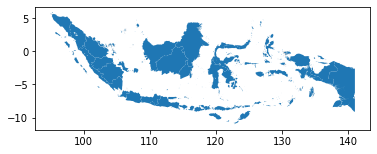

In [4]:
indonesia.plot()

In [5]:
indonesia.set_index("Propinsi", inplace=True)

In [6]:
indonesia.loc['JAWA TIMUR'] # show only the specific data of JAWA TIMUR

ID                                                            8
kode                                                         35
SUMBER                Peta Dasar BAKOSURTANAL Skala 1 : 250.000
Jumlah_Pen                                             37476757
geometry      (POLYGON ((111.694595 -6.752857, 111.696495 -6...
Name: JAWA TIMUR, dtype: object

In [7]:
jatim = gpd.GeoSeries(indonesia.loc['JAWA TIMUR']['geometry'])
type(jatim)

geopandas.geoseries.GeoSeries

<AxesSubplot:>

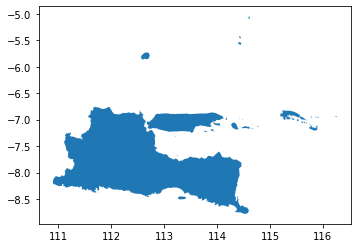

In [8]:
jatim.plot() 

<AxesSubplot:>

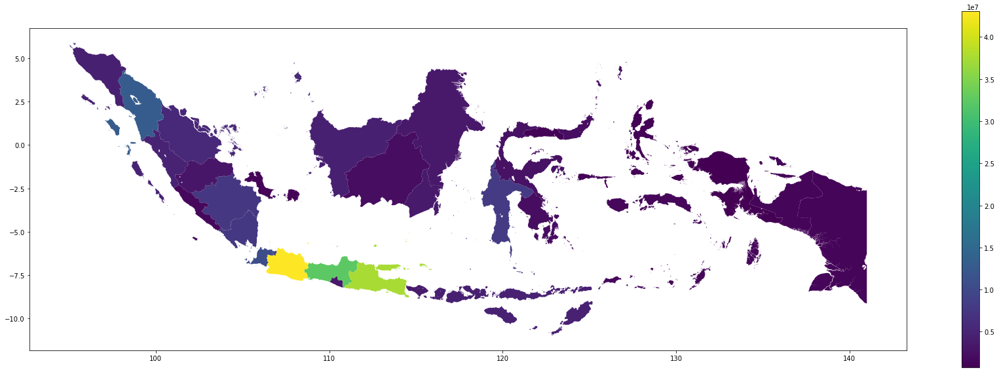

In [9]:
fig, ax = plt.subplots(1, 1, figsize=(30, 10) )
indonesia = indonesia[indonesia['Jumlah_Pen'].notnull()]
indonesia.plot(column='Jumlah_Pen', ax=ax, legend=True)

In [10]:
m = folium.Map([0.9329423, 117.1169259], zoom_start=5, tiles="OpenStreetMap")
folium.Choropleth(geo_data=indonesia ,data=indonesia, columns=['ID', 'Jumlah_Pen'],
             key_on='feature.properties.ID', fill_color='OrRd', highlight=True).add_to(m)

In [11]:
m